In [1]:
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import HTML

from geometric_graph import GeometricGraph
from graph_animation import graph_animation

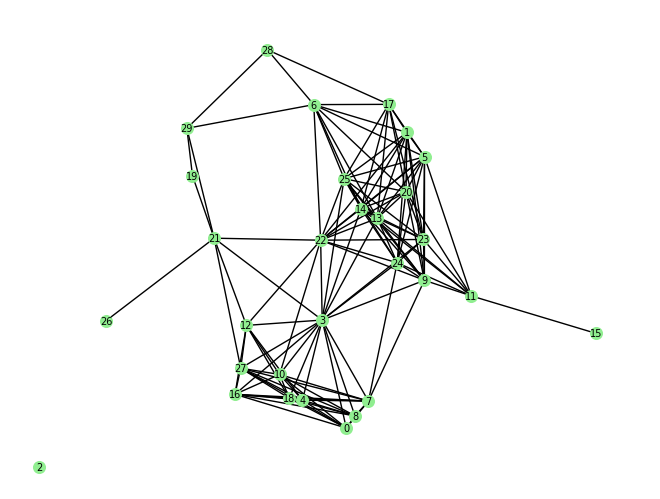

In [2]:
n = 30
eps = 1
rng = np.random.default_rng(seed=42)
coordinates_0 = rng.normal(size=(n, 2))

G = GeometricGraph(coordinates=coordinates_0, dist_to_adj=eps)
G.plot()

In [3]:
# Computing the graphs dynamics (list of graphs)
graphs = [G]
dt = 0.01
n_steps = 100

coordinates = coordinates_0
for i in range(n_steps):
    coordinates = coordinates + np.sqrt(dt) * rng.normal(size=(n, 2))
    graphs.append(GeometricGraph(coordinates=coordinates, dist_to_adj=eps))

In [4]:
ani = graph_animation(graphs)
# Display in Jupyter
plt.close()
HTML(ani.to_jshtml())

### Degree distribution

In [82]:
n = 5000
eps = 0.3

dim = 2
eps = n**(-1 / (4 * dim))
print(eps)
rng = np.random.default_rng(seed=42)
coordinates_0 = rng.normal(size=(n, 2))

G = GeometricGraph(coordinates=coordinates_0, dist_to_adj=eps)
# G.plot()

0.34484882412482154


(array([2.10398182, 2.06586621, 1.89053439, 2.24119802, 1.65421759,
        2.14209743, 2.22595178, 1.9972581 , 2.32505237, 2.56899229,
        2.19545929, 1.85241878, 1.61610198, 1.66946383, 1.91340376,
        1.57036324, 1.94389625, 1.83717253, 1.73807194, 0.56411107]),
 array([0.        , 0.02623597, 0.05247194, 0.0787079 , 0.10494387,
        0.13117984, 0.15741581, 0.18365178, 0.20988775, 0.23612371,
        0.26235968, 0.28859565, 0.31483162, 0.34106759, 0.36730355,
        0.39353952, 0.41977549, 0.44601146, 0.47224743, 0.49848339,
        0.52471936]),
 <BarContainer object of 20 artists>)

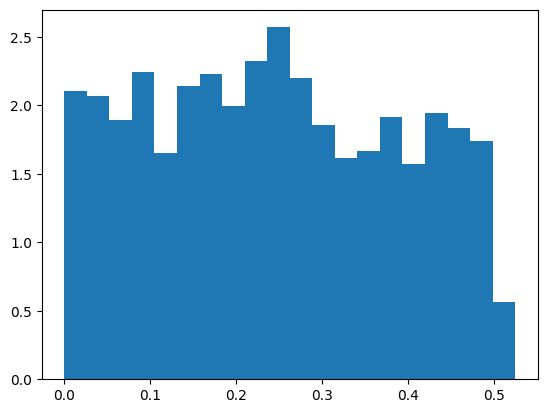

In [84]:
vert_degrees = G.adj_mat.sum(axis=0)
plt.hist(vert_degrees / n**(0.75), bins=20, density=True) # correct scaling for this eps

### Poisson field viewpoint

In [95]:
import scipy.stats as stats

n = 1
eps = 3
dim = 2

def scaled_normal(t, x):
    return t * stats.multivariate_normal.pdf(x, mean=[0, 0], cov=[[1, 0], [0, 1]])

alpha = 1
M0 = 0.01
sigma0 = np.sqrt(0.15)
B0 = 1 / sigma0**2
A0 = M0 / (2 * np.pi * sigma0**2)**(0.5 * dim)

def _A(t, x):
    e = np.exp(-t / alpha)
    return A0**(e) * (1 / e + 2 * alpha * B0 * (1/e - 1))**(-(dim * e * alpha * B0) / (1 + 2 * alpha * B0))

def _B(t, x):
    e = np.exp(-t / alpha)
    return B0 * e / (1 + 2 * alpha * B0 * (1 - e))

def wfr_gradient_flow(t, x):
    return _A(t, x) * np.exp(-0.5 * _B(t, x) * np.sum(x**2, axis=1))

mu_t = wfr_gradient_flow

R_max = 5
T_max = 7
mu_max = mu_t(T_max, np.zeros((1, 2)))

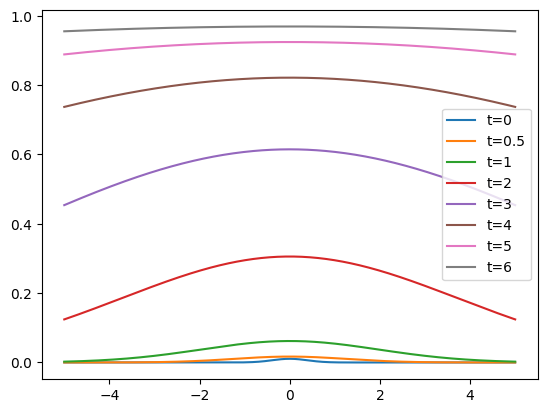

In [96]:
x_grid = np.linspace(-R_max, R_max, 500)
for t in [0, 0.5, 1, 2, 3, 4, 5, 6]:
    plt.plot(x_grid, wfr_gradient_flow(t, x_grid[:, None]), label=f"t={t}")
plt.legend()

In [97]:
N_points

np.int64(107)

In [98]:
rng = np.random.default_rng(seed=42)
N_points = rng.poisson(lam=(2 * R_max)**2 * mu_max * n)[0]

coordinates = rng.uniform(low=-R_max, high=R_max, size=(N_points, 2))
U = rng.uniform(low=0, high=mu_max, size=N_points)

In [99]:
t_grid = np.linspace(0, T_max, 100)

graphs = []

for t in t_grid:
    idx = U < mu_t(t, coordinates)
    print(idx.sum())
    graphs.append(GeometricGraph(coordinates=coordinates[idx], dist_to_adj=eps, names=np.arange(N_points)[idx]))

0
0
0
0
0
0
0
0
0
0
0
0
0
1
1
1
1
1
2
3
4
4
8
9
12
15
16
20
21
24
27
29
30
35
43
45
48
50
52
55
55
58
59
60
63
68
69
71
75
75
77
79
79
79
80
82
82
84
86
87
87
88
90
90
92
94
96
96
96
97
97
97
98
100
102
102
103
103
104
104
104
105
106
106
106
106
106
106
106
106
106
107
107
107
107
107
107
107
107
107


In [100]:
ani = graph_animation(graphs)
# Display in Jupyter
plt.close()
HTML(ani.to_jshtml())

Animation size has reached 21149708 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.
